In [1]:
import sys
import subprocess

#import pkg_resources
#required = {'harmonypy','sklearn','scanpy','pandas', 'numpy', 'bbknn', 'scipy', 'matplotlib', 'seaborn' ,'scipy'}
#installed = {pkg.key for pkg in pkg_resources.working_set}
#missing = required - installed
#if missing:
#    print("Installing missing packages:" )
#    print(missing)
#    python = sys.executable
#    subprocess.check_call([python, '-m', 'pip', 'install', *missing], stdout=subprocess.DEVNULL)

%matplotlib inline
from collections import Counter
from collections import defaultdict
import scanpy as sc
import pandas as pd
import pickle as pkl
import numpy as np
from bbknn import bbknn
import scipy
import matplotlib.pyplot as plt
import re
import glob
import os
import sys
from geosketch import gs
from numpy import cov
import scipy.cluster.hierarchy as spc
import seaborn as sns; sns.set(color_codes=True)
from sklearn.linear_model import LogisticRegression
import sklearn
import harmonypy as hm
from pathlib import Path

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.set_figure_params(dpi=300, color_map='viridis')
plt.rcParams['figure.figsize'] = [10, 10]

In [2]:
adata = sc.read('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_data/A4_V6_YS_integrated_data_singlets_with_raw_counts_for_MS_plotting_20211111_with_obsp.h5ad')

# Subset to endo

In [3]:
list(adata.obs['cell.labels'].unique())

['Sinusoidal_EC',
 'MEMP',
 'HSPC_1',
 'Erythroid',
 'Endoderm',
 'Immature_EC',
 'Macrophage',
 'MK',
 'Early_Erythroid',
 'Lymphoid_progenitor',
 'Mesothelium',
 'Prolif_Sinusoidal_EC',
 'Fibroblast',
 'HSPC_2',
 'AEC',
 'Mast_cell',
 'MOP',
 'DC2',
 'CMP',
 'DC_precursor',
 'HE',
 'Monocyte',
 'LMPP',
 'Neutrophil_precursor',
 'Microglia',
 'Smooth_Muscle',
 'Promonocyte',
 'Eo_Baso_Mast_precursor',
 'ILC_precursor',
 'Pre_Macrophage',
 'VWF_EC',
 'Eo_Basophil',
 'Prolif_AEC',
 'NK',
 'Monocyte_Macrophage']

In [4]:
keep = [
'Sinusoidal_EC',
 'Immature_EC',
 'AEC',
 'HE',
 'VWF_EC',
]
adata = adata[adata.obs['cell.labels'].isin(keep)]

In [22]:
adata.var[adata.var.index.str.contains('INS')]

,n_cells,mt,total_counts,highly_variable,intersect,means,dispersions,dispersions_norm
GINS1,7600,False,9026.0,False,True,0.049412,0.589492,-0.107413
GINS2,25413,False,58335.0,True,True,0.273344,0.991930,0.612591
GINS3,4991,False,5553.0,False,True,0.031303,0.633240,-0.029144
GINS4,6666,False,7592.0,False,True,0.043844,0.764410,0.205533
INS-IGF2,559,False,586.0,False,False,0.005513,0.796177,0.262368
INSC,94,False,99.0,False,True,0.000682,0.690198,0.072759
INSIG1,29364,False,71531.0,True,True,0.347175,1.273932,1.117122
INSIG2,21148,False,31452.0,False,True,0.184401,0.752299,0.183865
INSL3,161,False,162.0,False,True,0.001129,0.355667,-0.525752
INSL4,287,False,325.0,False,False,0.001983,1.462941,1.455278


In [23]:
#insulin genes
ins_genes={
'ins':['INS-IGF2'],
'ins-like':['INSL3','INSL4','INSL6'],
'ins_promoters':['INSC','INSM1','INSM2'],
'ins_receptor':['INSR'],
'ins_induced_gene':['INSIG1','INSIG2']}

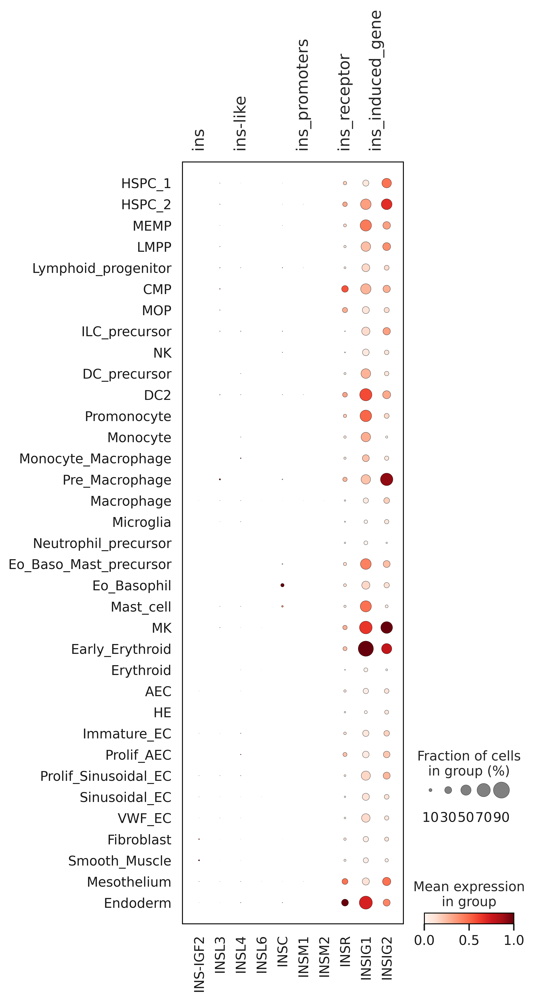

In [24]:
sc.pl.dotplot(adata, var_names = ins_genes, groupby='cell.labels',dendrogram=False, color_map='Reds', show = True,standard_scale='var',save='ins_genes')

In [5]:
round(max((np.array(score_mean)).max(0)))
(np.array(score_mean)).max(0)

NameError: name 'score_mean' is not defined

In [ ]:
round(m((np.array(scores.groupby('group').median())).max(0)))

In [ ]:
(scores.groupby('group').median()).mean()

In [ ]:
score_mean

In [ ]:
(min((np.array(score_mean)).min(0)))

In [ ]:
(max((np.array(score_mean)).max(0)))

In [ ]:
(max((np.array(score_mean)).max(0))) - ((max((np.array(score_mean)).max(0))) - (min((np.array(score_mean)).min(0))))/2

In [9]:
general_hsc = {
'HSC':["CD34",	"MLLT3",	"SPINK2",	"HOPX",	"HLF",	"CLEC9A",'PROM1','HLA-DRA','HLA-DRB1',	"HOXA3",	"HOXA4",	"HOXA5",	"HOXA7",	"HOXA10",],#
}

general_hsc_surface_markers = {
'HSC_markers':["CD34",	"MLLT3",	"SPINK2",	"HOPX","MLLT3","MECOM",	"HLF","HLF"],#
'HSC_maturity_markers':["CLEC9A","FLT3","CD48",'PROM1','HLA-DRA','HLA-DRB1',],
'HSC_surface_tetraspaninis':['CD9','CD81','CD63','CD24','CD74'],
'HSC_maintenance':["SOX17","HOXA3",	"HOXA4",	"HOXA5",	"HOXA7",	"HOXA9","HOXA10"],
}


HE_origin = {
'HSC':["KDR",	"FLT1",	"CDH5",],
}

HE_origin_alternate = {
'HSC':["KDR",	"FLT1",	"CDH5","ESAM",	"PECAM1",	"PLVAP",'IL33','ALDH1A1' , 'KCNK17'],
}

YS_HSP_DE_difinitive = {
'HSC':["ICAM3",	"SELL",	"PLAC8",	"CD74",	"SOX17",],
}

YS_HSP_DE_difinitive_alternate = {
'HSC':["ICAM3",	"SELL",	"PLAC8",	"CD74",	"SOX17","CD63",	"CD37",],
}


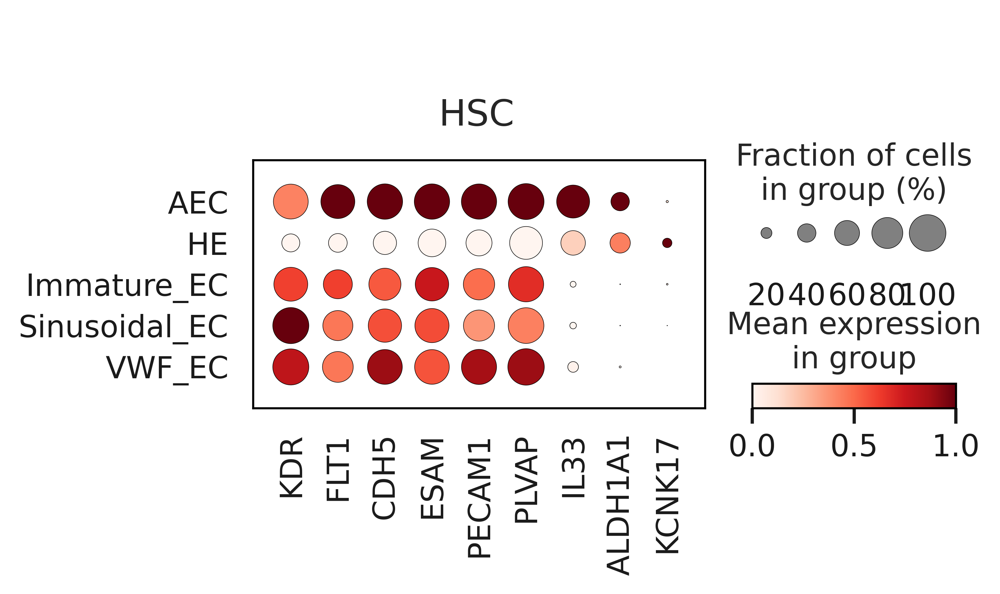

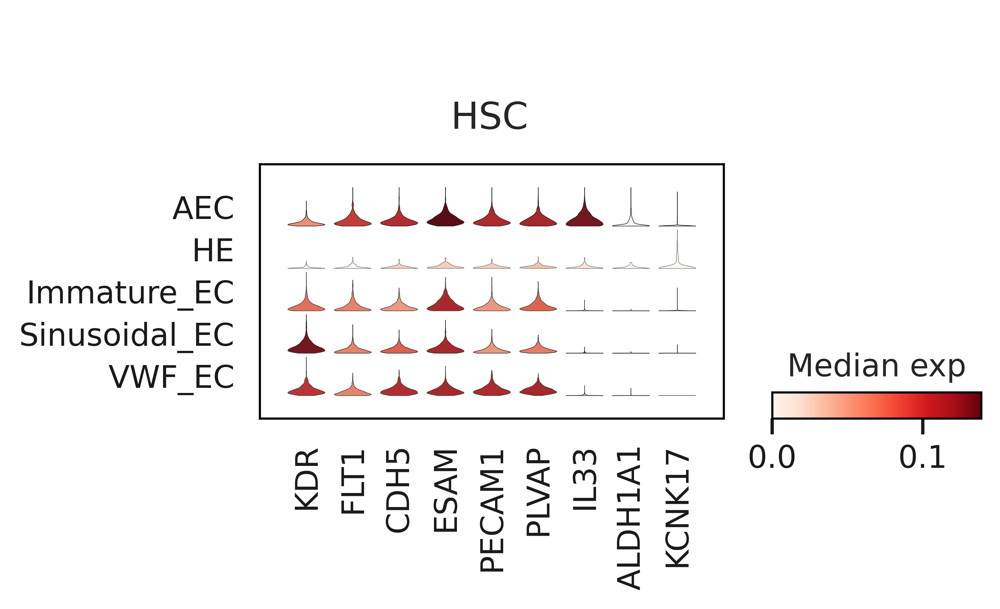

In [10]:
data_temp = adata
markers = HE_origin_alternate 
spot_var = 'cell.labels'
save_title = 'HE_origin_alternate'

(sc.pl.dotplot(data_temp, var_names = markers, groupby=spot_var,dendrogram=False, color_map='Reds', show = True,standard_scale='var',save =save_title))
sc.pl.stacked_violin(data_temp ,var_names= markers, groupby=spot_var,  log=False, use_raw=None, num_categories=7, title=None, colorbar_title='Median exp', figsize=None, dendrogram=False, gene_symbols=None, var_group_positions=None, var_group_labels=None, standard_scale='var', var_group_rotation=None, layer=None, stripplot=False, jitter=False, size=1, scale='width', yticklabels=False, order=None, swap_axes=False, show=None, save=save_title, return_fig=False, row_palette=None, cmap='Reds', ax=None, vmin=None, vmax=None, vcenter=None, norm=None)

183
computing score 'metabolic_score'
    finished: added
    'metabolic_score', score of gene set (adata.obs).
    788 total control genes are used. (0:00:00)
1312
computing score 'cell_cycle_score'
    finished: added
    'cell_cycle_score', score of gene set (adata.obs).
    899 total control genes are used. (0:00:00)
82
computing score 'cell_cell_adhesion_score'
    finished: added
    'cell_cell_adhesion_score', score of gene set (adata.obs).
    944 total control genes are used. (0:00:00)
225
computing score 'cell_matrix_adhesion_score'
    finished: added
    'cell_matrix_adhesion_score', score of gene set (adata.obs).
    937 total control genes are used. (0:00:00)
6
computing score 'endo_cell_matrix_adhesion_score'
    finished: added
    'endo_cell_matrix_adhesion_score', score of gene set (adata.obs).
    250 total control genes are used. (0:00:00)
47
computing score 'GNF2_SELL_score'
    finished: added
    'GNF2_SELL_score', score of gene set (adata.obs).
    699 total con

<ipython-input-47-1a44665bd174>:17: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  scores['group'] = adata.obs['cell.labels']


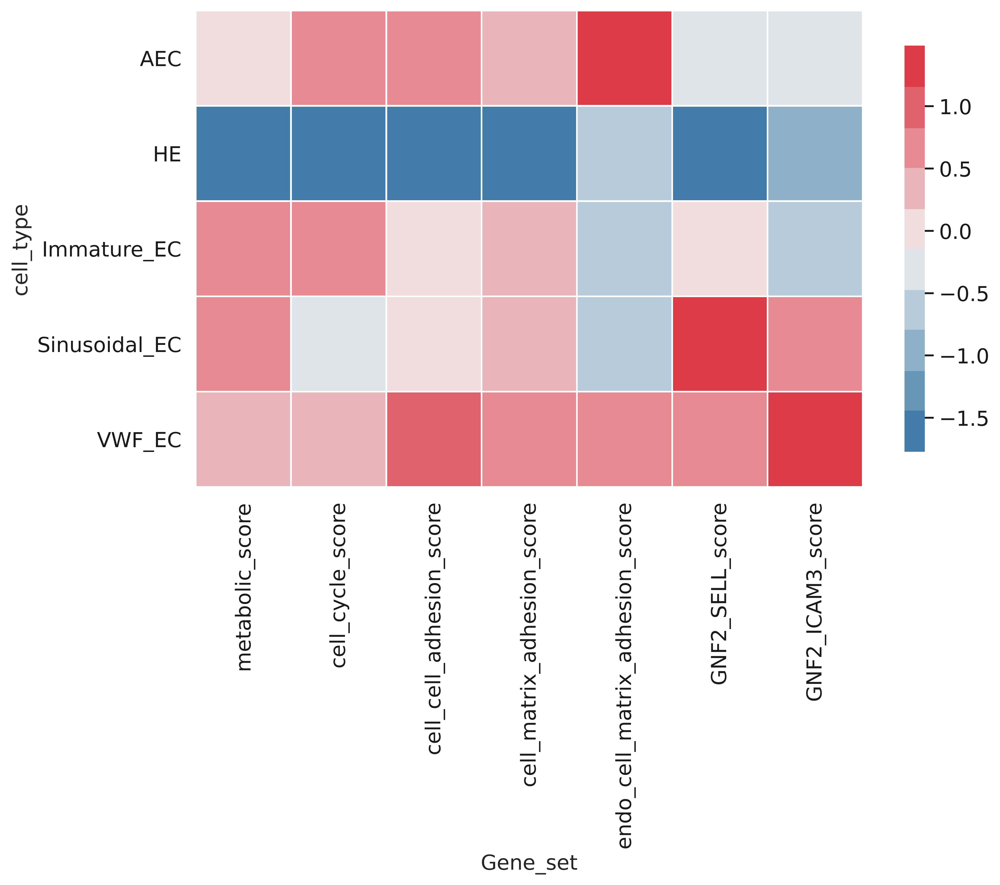

In [47]:
gene_sets = {'metabolic' :['/nfs/team205/ig7/resources/GO-0045333_cell_respiration.csv'],
'cell_cycle' : ['/nfs/team205/ig7/resources/GO-0022402_cell_cycle_genes.csv'],
'cell_cell_adhesion':['/nfs/team205/ig7/resources/GO_0016337_cell_cell_adhesion.csv'],
'cell_matrix_adhesion': ['/nfs/team205/ig7/resources/GO_0007160_cell_matrix_adhesion.csv'],
'endo_cell_matrix_adhesion' :[ '/nfs/team205/ig7/resources/GO_0090673_endo_cell_matrix_adhesion.csv'],
'GNF2_SELL':['/nfs/team205/ig7/resources/GNF2_SELL.csv'],
'GNF2_ICAM3':['/nfs/team205/ig7/resources/GNF2_ICAM3.csv'],}
for i in gene_sets.keys():
    gene_list_loc = ''.join(str(e) for e in gene_sets[i])
    gene_list_name = i
    gene_list = list(pd.read_csv(gene_list_loc,header=None)[0])
    gene_list = list(adata.var.index[adata.var.index.isin(gene_list)])
    print(len(gene_list))
    sc.tl.score_genes(adata, gene_list, ctrl_size=50, gene_pool=None, n_bins=25, score_name=(gene_list_name + '_score'), random_state=0, copy=False, use_raw=None)
    
scores = adata.obs[[s + '_score' for s in list(gene_sets.keys())]]
scores['group'] = adata.obs['cell.labels']
scores.groupby('group').median()

#Plot
pal = sns.diverging_palette(240, 10, n=10)
score_mean = scores.groupby('group').mean()
#Z_score the data
score_mean= (score_mean - score_mean.mean())/score_mean.std()

max_val = (max((np.array(score_mean)).max(0)))
min_val = (min((np.array(score_mean)).min(0)))
mid_val = (max((np.array(score_mean)).max(0))) - ((max((np.array(score_mean)).max(0))) - (min((np.array(score_mean)).min(0))))/2
g = sns.heatmap(score_mean, cmap=pal,  annot=False,vmin=min_val, vmax=max_val, linewidths=1, center=mid_val, square=True, cbar_kws={"shrink": 0.5})
plt.ylabel("cell_type")
plt.xlabel("Gene_set")
plt.savefig('./genesets',dpi=300)

In [ ]:
spot_var = 'cell.labels'
DE_name = 'endo_DE.csv'
sc.tl.rank_genes_groups(adata, spot_var, method='wilcoxon',n_genes=500)
sc.pl.rank_genes_groups(adata, n_genes=50, sharey=False)
result = adata.uns['rank_genes_groups']
groups = result['names'].dtype.names
    
DE = pd.DataFrame(
    {group + '_' + key[:1]: result[key][group]
    for group in groups for key in ['names', 'pvals','logfoldchanges']}).head(500)
#DE_name ="./DEGS_gastrulation_211121.csv"
DE.to_csv(DE_name)
degs = DE[:]
if 'concat' in locals() or 'concat' in globals():
    del(concat)
n = degs.loc[:, degs.columns.str.endswith("_n")]
n = pd.melt(n)
p = degs.loc[:, degs.columns.str.endswith("_p")]
p = pd.melt(p)
l = degs.loc[:, degs.columns.str.endswith("_l")]
l = pd.melt(l)
n = n.replace(regex=r'_n', value='')
n = n.rename(columns={"variable": "cluster", "value": "gene"})
p = (p.drop(["variable"],axis = 1)).rename(columns={ "value": "p_val"})
l = (l.drop(["variable"],axis = 1)).rename(columns={ "value": "logfc"})

In [ ]:
concat = pd.concat([n,p,l],axis=1)
#remove mito genes from data
concat = concat[~concat["gene"].str.startswith("MT-")]
concat = concat[~concat["gene"].str.startswith("RP11-")]
concat["cluster"] = concat["cluster"].astype(str)
marker_df = concat.groupby('cluster').apply(lambda grp: grp.nsmallest(20, 'p_val')).reset_index(drop=True)
marker_df = marker_df.groupby('cluster').apply(lambda grp: grp.nlargest(5, 'logfc')).reset_index(drop=True)
markers = marker_df.groupby('cluster')['gene'].apply(list).to_dict()
markers = dict(sorted(markers.items()))
markers = {str(k):v for k,v in markers.items()}
data_temp = adata
markers = markers

In [69]:
 markers ={'AEC': ['GJA5', 'IL33', 'CLEC14A', 'TMEM100', 'HSPG2','SOX17'],
 'HE': ['RACK1', 'ATP5MC2', 'CD24', 'ATP5F1B', 'ATP5F1A'],
 'Immature_EC': ['ENO1', 'LDHB', 'HPGD', 'ARHGAP18', 'FABP5'],
 'Sinusoidal_EC': ['B2M', 'DAB2', 'LYVE1', 'STAB2', 'GPX1'],
 'VWF_EC': ['ACP5', 'IGFBP7', 'MADCAM1', 'APLNR', 'ICAM1']}

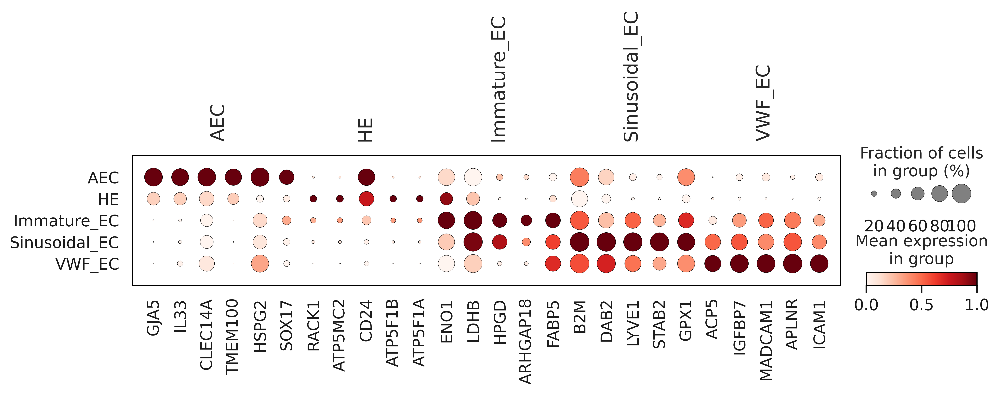

In [70]:
(sc.pl.dotplot(data_temp, var_names = markers, groupby=spot_var,dendrogram=False,standard_scale='var', color_map='Reds', show = True, save = 'diff_expression_endo.pdf')) # title=i

In [59]:
# import gseapy
# names = gseapy.get_library_name()

# # show top 20 entries.
# list(names)

In [112]:
marker_df = concat.groupby('cluster').apply(lambda grp: grp.nsmallest(30, 'p_val')).reset_index(drop=True)
marker_df = marker_df.groupby('cluster').apply(lambda grp: grp.nlargest(30, 'logfc')).reset_index(drop=True)

In [113]:
marker_df

,cluster,gene,p_val,logfc
0,AEC,GJA5,0.000000e+00,18.585878
1,AEC,IL33,0.000000e+00,15.576458
2,AEC,CLEC14A,2.640341e-251,14.030470
3,AEC,TMEM100,0.000000e+00,13.149888
4,AEC,HSPG2,2.772080e-246,12.506060
...,...,...,...,...
145,VWF_EC,CD59,6.120826e-98,2.848691
146,VWF_EC,FLRT2,1.859364e-123,2.790757
147,VWF_EC,KLF4,2.797213e-92,2.598617
148,VWF_EC,FOXP1,7.091402e-99,2.514843


In [114]:
enr_res.res2d

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Biological_Process_2021,heart development (GO:0007507),7/164,1.628029e-07,0.000124,0,0,20.523034,320.789902,CDKN1A;FLRT2;FN1;APLNR;TEK;SOX4;FBN1
1,GO_Biological_Process_2021,circulatory system development (GO:0072359),6/126,7.023936e-07,0.000193,0,0,22.534091,319.280393,CDKN1A;FN1;APLNR;TEK;SOX4;FBN1
2,GO_Biological_Process_2021,regulation of inflammatory response (GO:0050727),7/206,7.620954e-07,0.000193,0,0,16.157181,227.609348,NFKBIA;ANXA1;NFKBIZ;PDE2A;TEK;KLF4;FOXP1
3,GO_Biological_Process_2021,cytokine-mediated signaling pathway (GO:0019221),10/621,2.594454e-06,0.000403,0,0,7.912848,101.776111,NFKBIA;SOCS3;IFITM1;CDKN1A;ANXA1;IRF1;FN1;CXCL...
4,GO_Biological_Process_2021,cellular response to cytokine stimulus (GO:007...,9/482,2.650421e-06,0.000403,0,0,9.038983,116.067701,SOCS3;CDKN1A;ANXA1;IRF1;PDE2A;FN1;CXCL2;JUNB;I...
...,...,...,...,...,...,...,...,...,...,...
755,GO_Biological_Process_2021,MAPK cascade (GO:0000165),1/303,5.343118e-01,0.537139,0,0,1.327747,0.832200,TEK
756,GO_Biological_Process_2021,intracellular protein transport (GO:0006886),1/336,5.718076e-01,0.574074,0,0,1.194944,0.667917,ARL5B
757,GO_Biological_Process_2021,protein transport (GO:0015031),1/369,6.063399e-01,0.607940,0,0,1.085958,0.543321,ARL5B
758,GO_Biological_Process_2021,organelle organization (GO:0006996),1/420,6.544076e-01,0.655270,0,0,0.951293,0.403372,SEMA6A


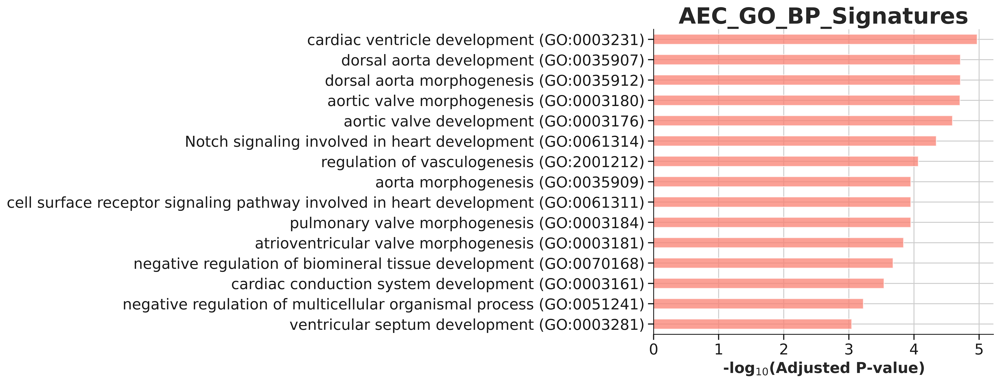

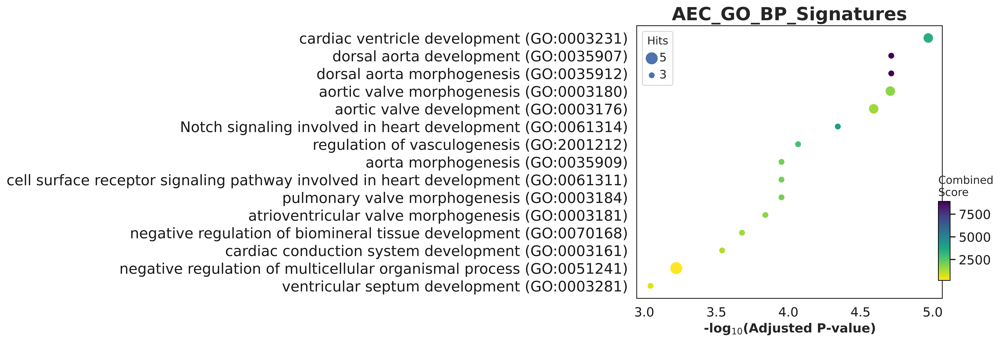

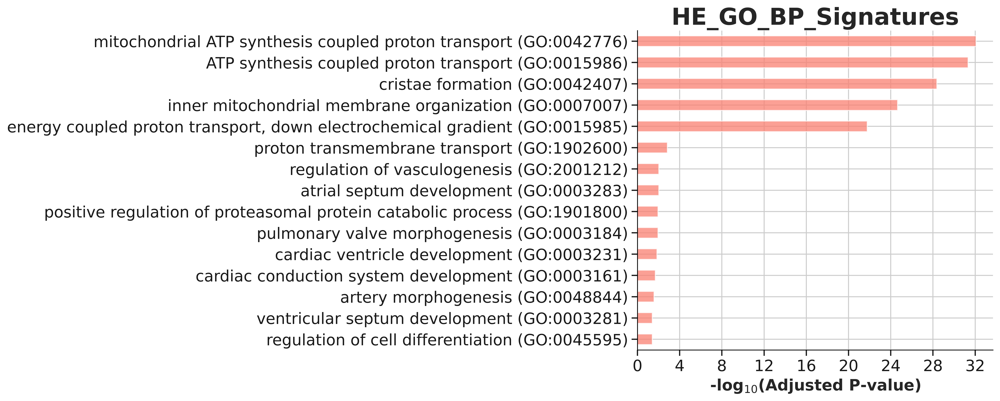

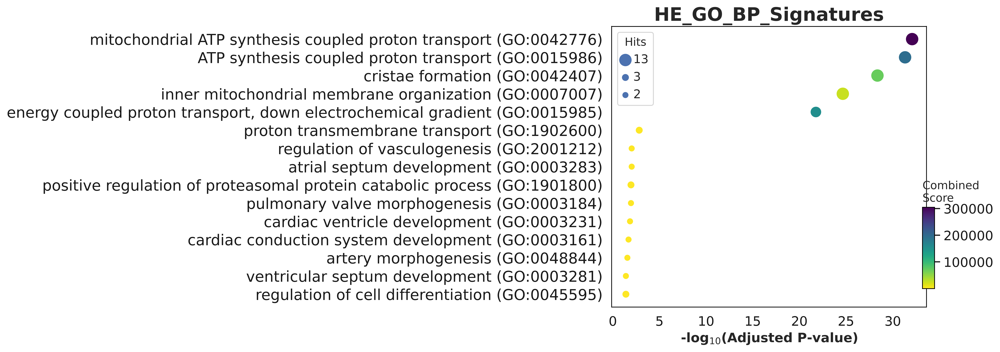

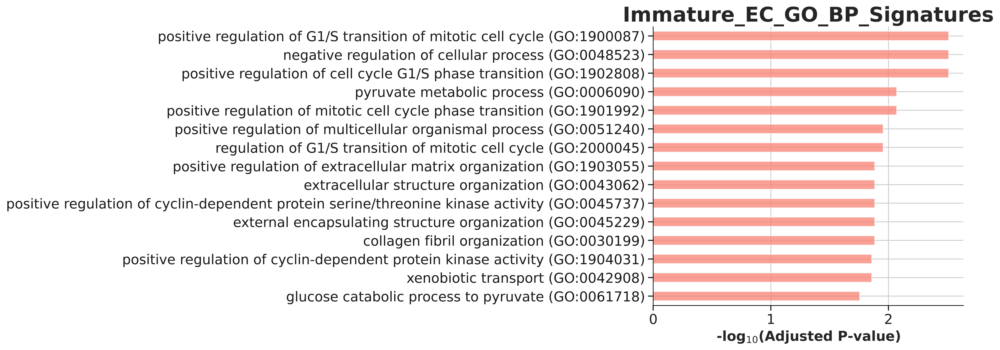

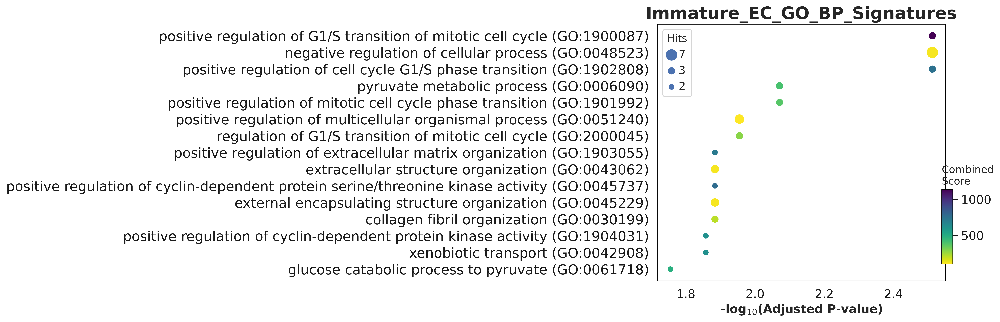

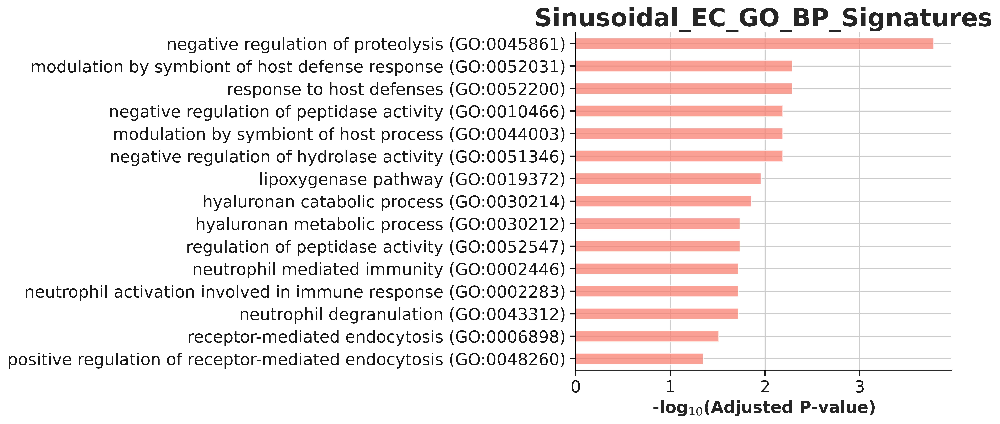

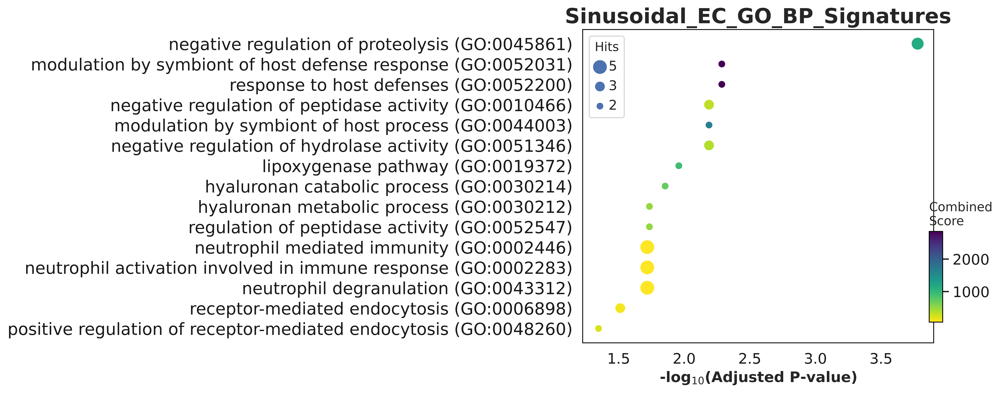

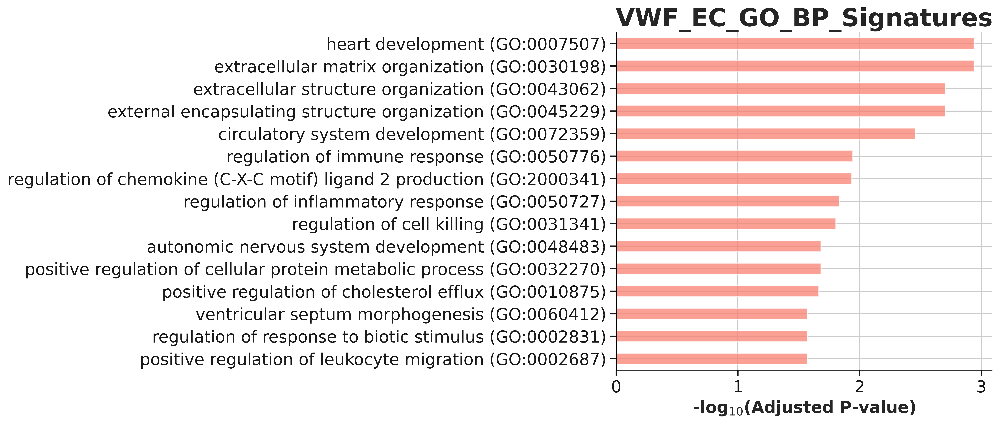

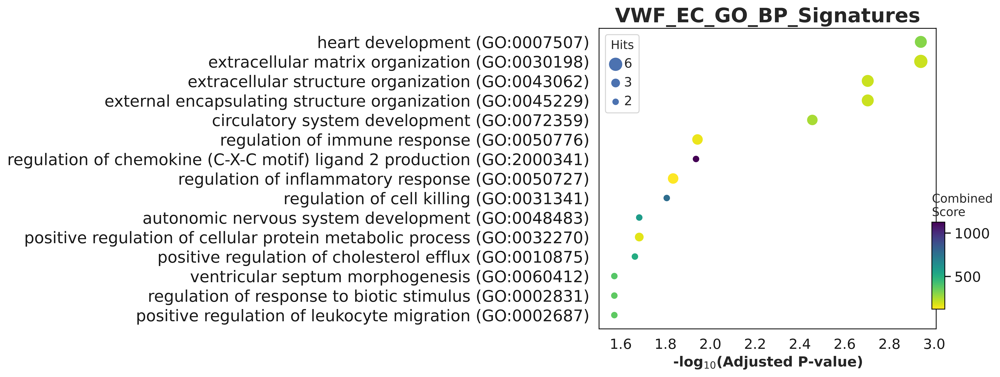

In [115]:
import gseapy
gene_set_names = gseapy.get_library_name(database='Human')

for i in list(marker_df['cluster'].unique()):
    #Available databases : 'Human', 'Mouse', 'Yeast', 'Fly', 'Fish', 'Worm' 
    import gseapy
    gene_set_names = gseapy.get_library_name(database='Human')
    glist = list(marker_df['gene'][marker_df['cluster'].isin([i])])
                                
    enr_res = gseapy.enrichr(gene_list=glist,
                     organism='Human',
                     gene_sets='GO_Biological_Process_2021' ,#'GO_Molecular_Function_2021', #''GO_Biological_Process_2021',
                     description='pathway',
                     cutoff = 0.05)
    enr_res.res2d.to_csv('./'+i+'_enr_res_score.csv')
    gseapy.barplot(enr_res.res2d,title=(i+ '_GO_BP_Signatures'),top_term=15)
    gseapy.dotplot(enr_res.res2d, title=(i+'_GO_BP_Signatures'),cmap='viridis_r',top_term=15)

# Create dictionary of genesets

In [29]:
DE =pd.read_csv('/nfs/team205/ig7/work_backups/backup_210306/projects/YS/YS_310122_notebooks/fig4_endo/endo_gene_module_score/endo_DE.csv')
degs = DE[:]
if 'concat' in locals() or 'concat' in globals():
    del(concat)
n = degs.loc[:, degs.columns.str.endswith("_n")]
n = pd.melt(n)
p = degs.loc[:, degs.columns.str.endswith("_p")]
p = pd.melt(p)
l = degs.loc[:, degs.columns.str.endswith("_l")]
l = pd.melt(l)
n = n.replace(regex=r'_n', value='')
n = n.rename(columns={"variable": "cluster", "value": "gene"})
p = (p.drop(["variable"],axis = 1)).rename(columns={ "value": "p_val"})
l = (l.drop(["variable"],axis = 1)).rename(columns={ "value": "logfc"})

In [30]:
concat = pd.concat([n,p,l],axis=1)
#remove mito genes from data
concat = concat[~concat["gene"].str.startswith("MT-")]
concat = concat[~concat["gene"].str.startswith("RP11-")]
concat["cluster"] = concat["cluster"].astype(str)
marker_df = concat.groupby('cluster').apply(lambda grp: grp.nsmallest(20, 'p_val')).reset_index(drop=True)
marker_df = marker_df.groupby('cluster').apply(lambda grp: grp.nlargest(5, 'logfc')).reset_index(drop=True)
markers = marker_df.groupby('cluster')['gene'].apply(list).to_dict()
markers = dict(sorted(markers.items()))
markers = {str(k):v for k,v in markers.items()}
data_temp = adata
markers = markers

In [31]:
markers

{'AEC': ['GJA5', 'IL33', 'CLEC14A', 'TMEM100', 'HSPG2'],
 'HE': ['RACK1', 'ATP5MC2', 'CD24', 'ATP5F1B', 'ATP5F1A'],
 'Immature_EC': ['ENO1', 'LDHB', 'HPGD', 'ARHGAP18', 'FABP5'],
 'Sinusoidal_EC': ['B2M', 'DAB2', 'LYVE1', 'STAB2', 'GPX1'],
 'VWF_EC': ['ACP5', 'IGFBP7', 'MADCAM1', 'APLNR', 'ICAM1']}

In [90]:
 markers ={'AEC': ['GJA5', 'TMEM100', 'HSPG2','SOX17','HEY1','DLL4'],
 'HE': ['ATP5F1B', 'ATP5PO', 'ATP5MF', 'ATP5MC2', 'ATP5F1B', 'ATP5F1A'],
 'Immature_EC': ['RGCC', 'CCND1', 'RDX', 'HPGD', 'HMGA1'],
 'Sinusoidal_EC': ['LYVE1','CSTB', 'GMFG', 'PTX3', 'B2M', 'STAB2'],
 'VWF_EC': ['KLF4', 'FOXP1', 'NFKBIA', 'NFKBIZ', 'CD59', 'ICAM1']}
spot_var = 'cell.labels'

In [76]:
('GJA1;RGCC;HPGD;HMGA1;ENO1;HOPX;RTN4').split(';')

['GJA1', 'RGCC', 'HPGD', 'HMGA1', 'ENO1', 'HOPX', 'RTN4']

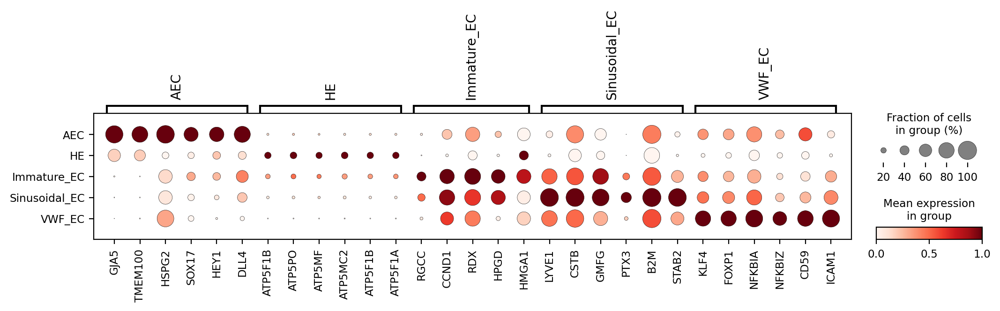

In [78]:
plt.rcParams.update(plt.rcParamsDefault)
(sc.pl.dotplot(data_temp, var_names = markers, groupby=spot_var,dendrogram=False,standard_scale='var', color_map='Reds', show = True, save = 'diff_expression_endo.pdf')) # title=i

In [22]:
adata.layers['scaled'] = sc.pp.scale(adata, copy=True).X

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [93]:
adata.obs['cell.labels'] = adata.obs['cell.labels'].astype('category')
cat_order = ['AEC', 'HE', 'Immature_EC', 'Sinusoidal_EC', 'VWF_EC']
adata.obs['cell.labels'] = adata.obs['cell.labels'].cat.reorder_categories(cat_order)

In [96]:
adata.obs['cell.labels'].cat.categories

Index(['AEC', 'HE', 'Immature_EC', 'Sinusoidal_EC', 'VWF_EC'], dtype='object')

In [121]:
 markers ={'Aortic angiogenesis and aasculogenesis': ['GJA5', 'TMEM100', 'HSPG2','SOX17','HEY1','DLL4'],
 'Mitochondial metabolic activity': ['ATP5F1B', 'ATP5PO', 'ATP5MF', 'ATP5MC2', 'ATP5F1B', 'ATP5F1A'],
 'Cell cylcing and checkpoints': ['RGCC', 'CCND1', 'RDX', 'HPGD', 'HMGA1'],
# 'Sinusoidal_EC': ['LYVE1','CSTB', 'GMFG', 'PTX3', 'B2M', 'STAB2'],
 'Immune response & Leukocyte trafficking': ['LYVE1','CSTB', 'GMFG', 'PTX3', 'B2M', 'STAB2','KLF4', 'FOXP1', 'NFKBIA', 'NFKBIZ', 'CD59', 'ICAM1']}
spot_var = 'cell.labels'

- VWF/Sinusoidal - Immune response & Leukocyte trafficking

- AEC - Cardiac/aortic/aorta/angiogenesis/blood vessel morphogenesis

- HE - Metabolic ATP/mitochondrial (i.e. metabolic)

- VWF and Sinusoidal I’ve been keeping together as “LYVE1+” with shared function, they don’s strikingly stand apart although I do know they have differential expression
- Immature: cell cylcing ad RGCC etc

In [122]:
markers ={'Aortic angiogenesis and aasculogenesis': ['GJA5', 'TMEM100', 'HSPG2','SOX17','HEY1','DLL4'],
 'Mitochondial metabolic activity': ['ATP5F1B', 'ATP5PO', 'ATP5MF', 'ATP5MC2', 'ATP5F1B', 'ATP5F1A'],
 'Cell cylcing and checkpoints': ['RGCC', 'CCND1', 'RDX', 'HPGD', 'HMGA1'],
 'Immune response & Leukocyte trafficking': ['LYVE1','CSTB', 'GMFG', 'PTX3', 'B2M', 'STAB2','KLF4', 'FOXP1', 'NFKBIA', 'NFKBIZ', 'CD59', 'ICAM1']}

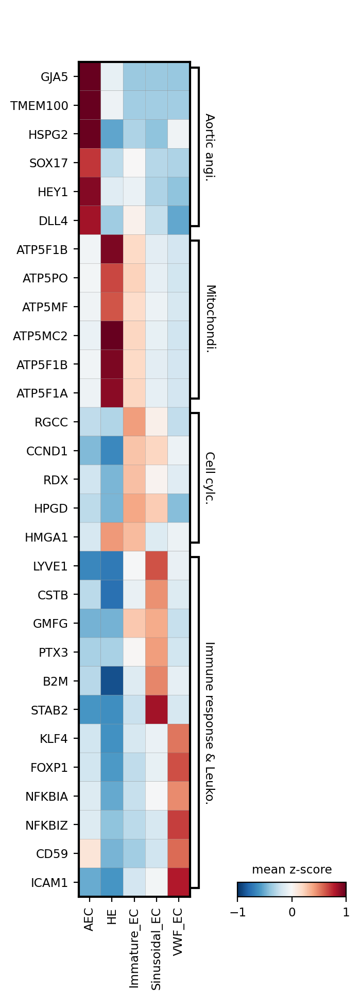

In [123]:
sc.pl.matrixplot(adata, markers, 'cell.labels', cmap='RdBu_r',dendrogram=False,categories_order = cat_order, colorbar_title='mean z-score', layer='scaled', vmin=-1, vmax=1,swap_axes = True,save = 'genesets_expression_endo.pdf')

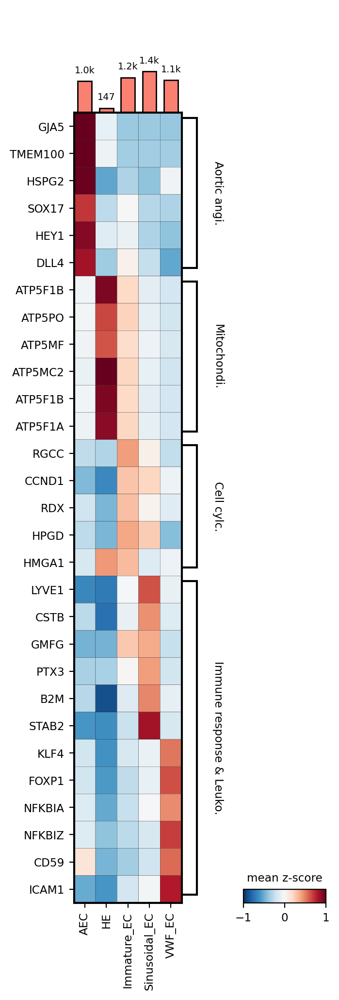

In [124]:
fig = sc.pl.matrixplot(adata, markers, 'cell.labels',return_fig=True,dendrogram=False,categories_order = cat_order, colorbar_title='mean z-score', layer='scaled', vmin=-1, vmax=1,swap_axes = True,save = 'genesets_expression_endo.pdf')
fig.add_totals().style(edge_color='black', cmap='RdBu_r')
fig.savefig('./figures/genesets_expression_endo.pdf')

In [ ]:
sc.pl.matrixplot(adata, markers, 'cell.labels',return_fig=True,dendrogram=False,categories_order = cat_order, colorbar_title='mean z-score', layer='scaled', vmin=-1, vmax=1,swap_axes = True,save = 'genesets_expression_endo.pdf')